## Keras implementation of https://junyanz.github.io/CycleGAN/

In [2]:
import os
os.environ['KERAS_BACKEND']='tensorflow' # can choose theano, tensorflow, cntk
os.environ['THEANO_FLAGS']='floatX=float32,device=cuda,optimizer=fast_run,dnn.library_path=/usr/lib'
#os.environ['THEANO_FLAGS']='floatX=float32,device=cuda,optimizer=fast_compile,dnn.library_path=/usr/lib'

In [3]:
import keras.backend as K
if os.environ['KERAS_BACKEND'] =='theano':
    channel_axis=1
    K.set_image_data_format('channels_first')
    channel_first = True
else:
    K.set_image_data_format('channels_last')
    channel_axis=-1
    channel_first = False

/home/k123/env/python2.7.12/local/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [4]:
from keras.models import Sequential, Model
from keras.layers import Conv2D, ZeroPadding2D, BatchNormalization, Input, Dropout
from keras.layers import Conv2DTranspose, Reshape, Activation, Cropping2D, Flatten
from keras.layers import Concatenate
from keras.layers.advanced_activations import LeakyReLU
from keras.activations import relu
from keras.initializers import RandomNormal

In [5]:
# Weights initializations
# bias are initailized as 0
def __conv_init(a):
    print("conv_init", a)
    k = RandomNormal(0, 0.02)(a) # for convolution kernel
    k.conv_weight = True    
    return k
conv_init = RandomNormal(0, 0.02)
gamma_init = RandomNormal(1., 0.02) # for batch normalization


In [6]:
# HACK speed up theano
if K._BACKEND == 'theano':
    import keras.backend.theano_backend as theano_backend
    def _preprocess_conv2d_kernel(kernel, data_format):
        #return kernel
        if hasattr(kernel, "original"):
            print("use original")
            return kernel.original
        elif hasattr(kernel, '_keras_shape'):
            s = kernel._keras_shape
            print("use reshape",s)
            kernel = kernel.reshape((s[3], s[2],s[0], s[1]))
        else:
            kernel = kernel.dimshuffle((3, 2, 0, 1))
        return kernel
    theano_backend._preprocess_conv2d_kernel = _preprocess_conv2d_kernel

In [12]:
# Basic discriminator
def conv2d(f, *a, **k):
    return Conv2D(f, kernel_initializer = conv_init, *a, **k)
def batchnorm():
    return BatchNormalization(momentum=0.9, axis=channel_axis, epsilon=1.01e-5,
                                   gamma_initializer = gamma_init)
def BASIC_D(nc_in, ndf, max_layers=3, use_sigmoid=True):
    """DCGAN_D(nc, ndf, max_layers=3)
       nc: channels
       ndf: filters of the first layer
       max_layers: max hidden layers
    """    
    if channel_first:
        input_a =  Input(shape=(nc_in, None, None))
    else:
#         input_a = Input(shape=(None, None, nc_in))
        input_a = Input(shape=(256, 256, nc_in))
    _ = input_a
    _ = conv2d(ndf, kernel_size=4, strides=2, padding="same", name = 'First') (_)
    _ = LeakyReLU(alpha=0.2)(_)
    
    for layer in range(1, max_layers):        
        out_feat = ndf * min(2**layer, 8)
        _ = conv2d(out_feat, kernel_size=4, strides=2, padding="same", 
                   use_bias=False, name = 'pyramid.{0}'.format(layer)             
                        ) (_)
        _ = batchnorm()(_, training=1)        
        _ = LeakyReLU(alpha=0.2)(_)
    
    out_feat = ndf*min(2**max_layers, 8)
    _ = ZeroPadding2D(1)(_)
    _ = conv2d(out_feat, kernel_size=4,  use_bias=False, name = 'pyramid_last') (_)
    _ = batchnorm()(_, training=1)
    _ = LeakyReLU(alpha=0.2)(_)
    
    # final layer
    _ = ZeroPadding2D(1)(_)
    _ = conv2d(1, kernel_size=4, name = 'final'.format(out_feat, 1), 
               activation = "sigmoid" if use_sigmoid else None) (_)    
    return Model(inputs=[input_a], outputs=_)

In [9]:
def UNET_G(isize, nc_in=3, nc_out=3, ngf=64, fixed_input_size=True):    
    max_nf = 8*ngf    
    def block(x, s, nf_in, use_batchnorm=True, nf_out=None, nf_next=None):
        # print("block",x,s,nf_in, use_batchnorm, nf_out, nf_next)
        assert s>=2 and s%2==0
        if nf_next is None:
            nf_next = min(nf_in*2, max_nf)
        if nf_out is None:
            nf_out = nf_in
        x = conv2d(nf_next, kernel_size=4, strides=2, use_bias=(not (use_batchnorm and s>2)),
                   padding="same", name = 'conv_{0}'.format(s)) (x)
        if s>2:
            if use_batchnorm:
                x = batchnorm()(x, training=1)
            x2 = LeakyReLU(alpha=0.2)(x)
            x2 = block(x2, s//2, nf_next)
            x = Concatenate(axis=channel_axis)([x, x2])            
        x = Activation("relu")(x)
        x = Conv2DTranspose(nf_out, kernel_size=4, strides=2, use_bias=not use_batchnorm,
                            kernel_initializer = conv_init,          
                            name = 'convt.{0}'.format(s))(x)        
        x = Cropping2D(1)(x)
        if use_batchnorm:
            x = batchnorm()(x, training=1)
        if s <=8:
            x = Dropout(0.5)(x, training=1)
        return x
    
    s = isize if fixed_input_size else None
    if channel_first:
        _ = inputs = Input(shape=(nc_in, s, s))
    else:
        _ = inputs = Input(shape=(s, s, nc_in))        
    _ = block(_, isize, nc_in, False, nf_out=nc_out, nf_next=ngf)
    _ = Activation('tanh')(_)
    return Model(inputs=inputs, outputs=[_])

In [10]:
nc_in = 3
nc_out = 3
ngf = 64
ndf = 64
use_lsgan = True
lambda_ = 10 if use_lsgan else 100

loadSize = 143
imageSize = 128
batchSize = 1
lrD = 2e-4
lrG = 2e-4

In [16]:
netDA = BASIC_D(nc_in, ndf, use_sigmoid = not use_lsgan)
netDB = BASIC_D(nc_out, ndf, use_sigmoid = not use_lsgan)
netDA.summary()
# netDB.summary()


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_9 (InputLayer)         (None, 256, 256, 3)       0         
_________________________________________________________________
First (Conv2D)               (None, 128, 128, 64)      3136      
_________________________________________________________________
leaky_re_lu_37 (LeakyReLU)   (None, 128, 128, 64)      0         
_________________________________________________________________
pyramid.1 (Conv2D)           (None, 64, 64, 128)       131072    
_________________________________________________________________
batch_normalization_41 (Batc (None, 64, 64, 128)       512       
_________________________________________________________________
leaky_re_lu_38 (LeakyReLU)   (None, 64, 64, 128)       0         
_________________________________________________________________
pyramid.2 (Conv2D)           (None, 32, 32, 256)       524288    
__________

In [15]:
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot


netGB = UNET_G(imageSize, nc_in, nc_out, ngf)
netGA = UNET_G(imageSize, nc_out, nc_in, ngf)
#SVG(model_to_dot(netG, show_shapes=True).create(prog='dot', format='svg'))
netGA.summary()


__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
conv_128 (Conv2D)               (None, 64, 64, 64)   3136        input_8[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_31 (LeakyReLU)      (None, 64, 64, 64)   0           conv_128[0][0]                   
__________________________________________________________________________________________________
conv_64 (Conv2D)                (None, 32, 32, 128)  131072      leaky_re_lu_31[0][0]             
__________________________________________________________________________________________________
batch_norm

In [17]:
from keras.optimizers import RMSprop, SGD, Adam

In [18]:
if use_lsgan:
    loss_fn = lambda output, target : K.mean(K.abs(K.square(output-target)))
else:
    loss_fn = lambda output, target : -K.mean(K.log(output+1e-12)*target+K.log(1-output+1e-12)*(1-target))

def cycle_variables(netG1, netG2):
    real_input = netG1.inputs[0]
    fake_output = netG1.outputs[0]
    rec_input = netG2([fake_output])
    fn_generate = K.function([real_input], [fake_output, rec_input])
    return real_input, fake_output, rec_input, fn_generate

real_A, fake_B, rec_A, cycleA_generate = cycle_variables(netGB, netGA)
real_B, fake_A, rec_B, cycleB_generate = cycle_variables(netGA, netGB)

In [19]:
def D_loss(netD, real, fake, rec):
    output_real = netD([real])
    output_fake = netD([fake])
    loss_D_real = loss_fn(output_real, K.ones_like(output_real))
    loss_D_fake = loss_fn(output_fake, K.zeros_like(output_fake))
    loss_G = loss_fn(output_fake, K.ones_like(output_fake))
    loss_D = loss_D_real+loss_D_fake
    loss_cyc = K.mean(K.abs(rec-real))
    return loss_D, loss_G, loss_cyc

loss_DA, loss_GA, loss_cycA = D_loss(netDA, real_A, fake_A, rec_A)
loss_DB, loss_GB, loss_cycB = D_loss(netDB, real_B, fake_B, rec_B)
loss_cyc = loss_cycA+loss_cycB

In [20]:
loss_G = loss_GA+loss_GB+lambda_*loss_cyc
loss_D = loss_DA+loss_DB

weightsD = netDA.trainable_weights + netDB.trainable_weights
weightsG = netGA.trainable_weights + netGB.trainable_weights

training_updates = Adam(lr=lrD, beta_1=0.5).get_updates(weightsD,[],loss_D)
netD_train = K.function([real_A, real_B],[loss_DA/2, loss_DB/2], training_updates)
training_updates = Adam(lr=lrG, beta_1=0.5).get_updates(weightsG,[], loss_G)
netG_train = K.function([real_A, real_B], [loss_GA, loss_GB, loss_cyc], training_updates)

In [62]:
from PIL import Image
import numpy as np
import glob
from random import randint, shuffle

def load_data(file_pattern):
    return glob.glob(file_pattern)

def read_image(fn):
#     load image with BILINEAR resizing, and crop the central region. 143*143 -> 128*128
    im = Image.open(fn).convert('RGB')
    im = im.resize( (loadSize, loadSize), Image.BILINEAR )
#     normalize,[0,255] -> [-1,1]
    arr = np.array(im)/255. * 2 -1
#     print 'im',im
#     print arr
    w1,w2 = (loadSize-imageSize)//2,(loadSize+imageSize)//2
    h1,h2 = w1,w2
    img = arr[h1:h2, w1:w2, :]
#     horizontal flip
    if randint(0,1):
        img=img[:,::-1]
    if channel_first:        
        img = np.moveaxis(img, 2, 0)
    return img

#data = "edges2shoes"
data = "horse2zebra"
train_A = load_data('CycleGAN/{}/trainA/*.jpg'.format(data))
train_B = load_data('CycleGAN/{}/trainB/*.jpg'.format(data))
assert len(train_A) and len(train_B)

In [48]:
def minibatch(data, batchsize):
    length = len(data)
    epoch = i = 0
    tmpsize = None    
    while True:
        size = tmpsize if tmpsize else batchsize
        if i+size > length:
            shuffle(data)
            i = 0
            epoch+=1        
        rtn = [read_image(data[j]) for j in range(i,i+size)]
        i+=size
        tmpsize = yield epoch, np.float32(rtn)       

def minibatchAB(dataA, dataB, batchsize):
    batchA=minibatch(dataA, batchsize)
    batchB=minibatch(dataB, batchsize)
    tmpsize = None    
    while True:        
        ep1, A = batchA.send(tmpsize)
        ep2, B = batchB.send(tmpsize)
        tmpsize = yield max(ep1, ep2), A, B

In [74]:
from IPython.display import display
# import matplotlib.pyplot as plt
def showX(X, rows=1):
    assert X.shape[0]%rows == 0
    int_X = ( (X+1)/2*255).clip(0,255).astype('uint8')
    if channel_first:
        int_X = np.moveaxis(int_X.reshape(-1,3,imageSize,imageSize), 1, 3)
    else:
        int_X = int_X.reshape(-1,imageSize,imageSize, 3)
    int_X = int_X.reshape(rows, -1, imageSize, imageSize,3).swapaxes(1,2).reshape(rows*imageSize,-1, 3)
#     
#     im = im.resize( (loadSize, loadSize), Image.BILINEAR )
    display(Image.fromarray(int_X))
#     plt.imshow(int_X,aspect='auto')
#     plt.imshow(int_X)
#     plt.show()

(6, 128, 128, 3)


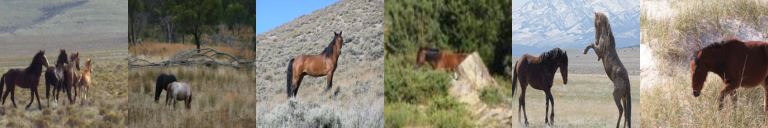

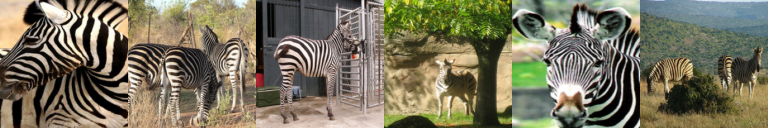

In [75]:
# train_batch = minibatchAB(train_A, train_B, 6)
train_batch = minibatchAB(train_A, train_B, 6)
_, A, B = next(train_batch)
print A.shape
# print A
showX(A)
showX(B)
del train_batch, A, B

In [78]:
def showG(A,B):
    assert A.shape==B.shape
    def G(fn_generate, X):
        r = np.array([fn_generate([X[i:i+1]]) for i in range(X.shape[0])])
        return r.swapaxes(0,1)[:,:,0]        
    rA = G(cycleA_generate, A)
    rB = G(cycleB_generate, B)
    print 'A',rA.shape
    arr = np.concatenate([A,B,rA[0],rB[0],rA[1],rB[1]])
    showX(arr, 3)

('[0/150][50] Loss_D: 0.274004 0.252283 Loss_G: 0.355158 0.481517 loss_cyc 0.194126', 20.703305959701538)
A (2, 4, 128, 128, 3)


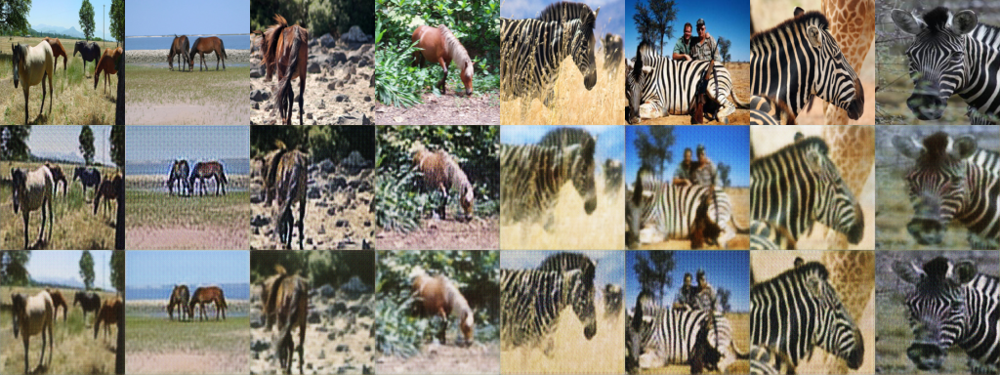

('[0/150][100] Loss_D: 0.275486 0.275651 Loss_G: 0.321071 0.462894 loss_cyc 0.182910', 41.787193059921265)
A (2, 4, 128, 128, 3)


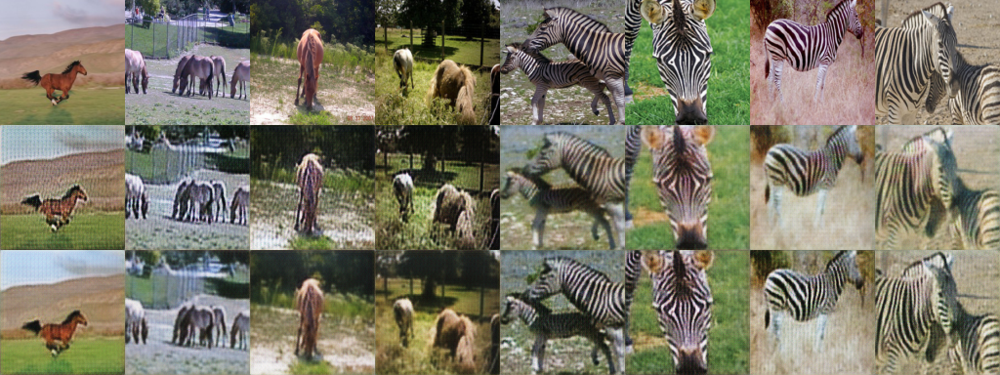

('[0/150][150] Loss_D: 0.274206 0.273602 Loss_G: 0.331474 0.473390 loss_cyc 0.185600', 62.83851599693298)
A (2, 4, 128, 128, 3)


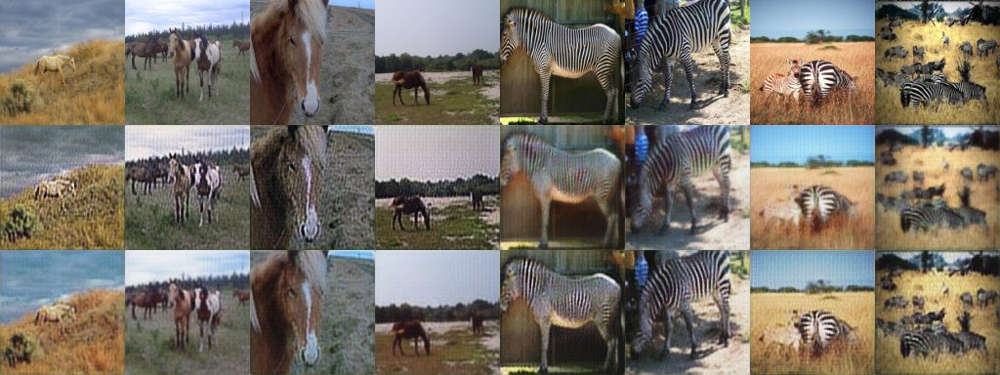

('[0/150][200] Loss_D: 0.279420 0.276413 Loss_G: 0.333898 0.445587 loss_cyc 0.180510', 83.91923999786377)
A (2, 4, 128, 128, 3)


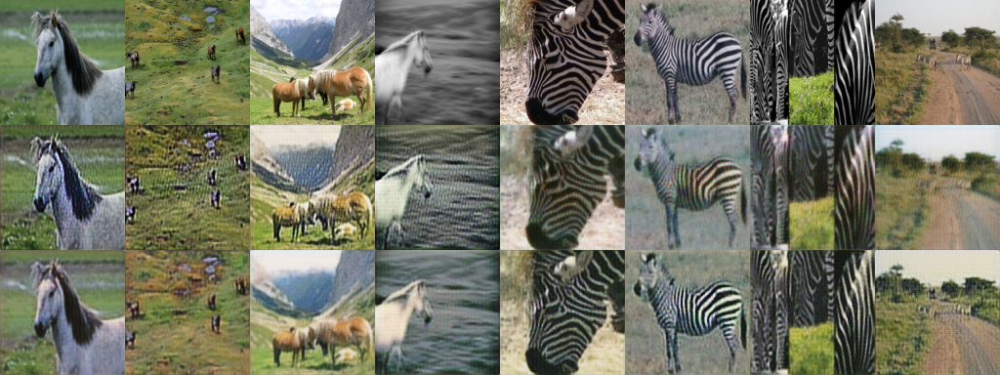

('[0/150][250] Loss_D: 0.278196 0.239680 Loss_G: 0.312645 0.445272 loss_cyc 0.180264', 104.96930003166199)
A (2, 4, 128, 128, 3)


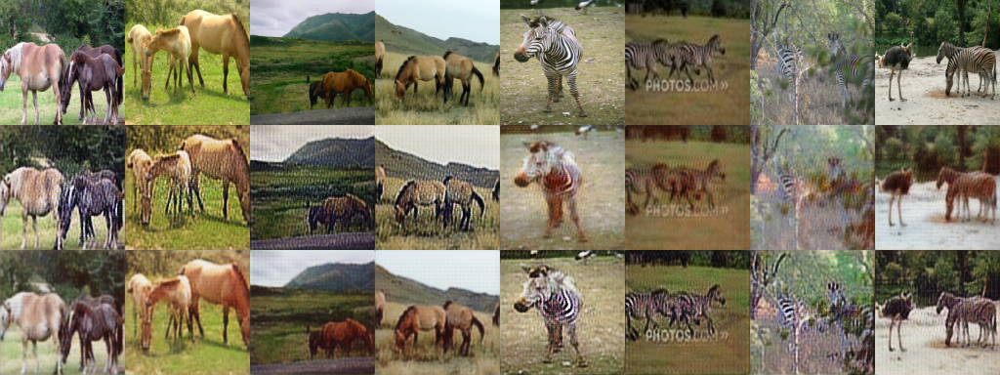

('[0/150][300] Loss_D: 0.265361 0.241495 Loss_G: 0.336346 0.488228 loss_cyc 0.190342', 126.02322387695312)
A (2, 4, 128, 128, 3)


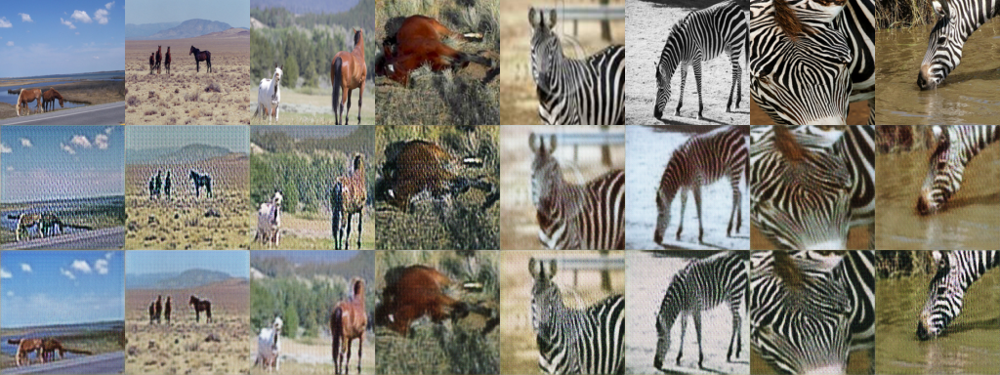

('[0/150][350] Loss_D: 0.269369 0.248517 Loss_G: 0.357594 0.449310 loss_cyc 0.183098', 147.07507300376892)
A (2, 4, 128, 128, 3)


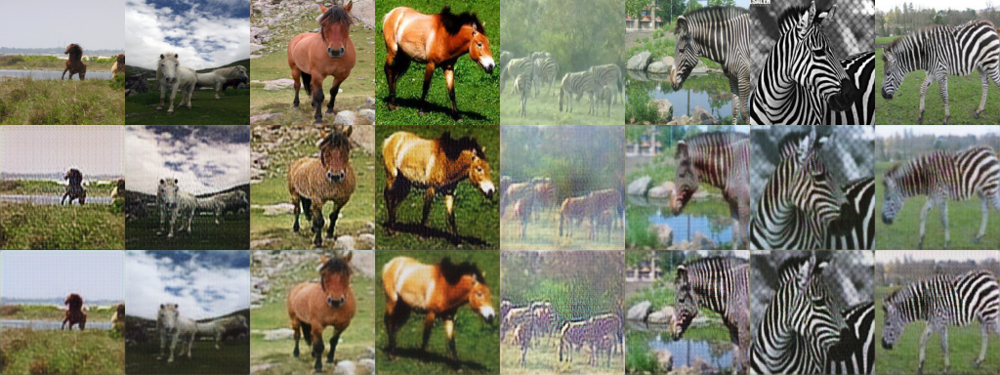

('[0/150][400] Loss_D: 0.304480 0.277039 Loss_G: 0.341594 0.443702 loss_cyc 0.164800', 168.1200830936432)
A (2, 4, 128, 128, 3)


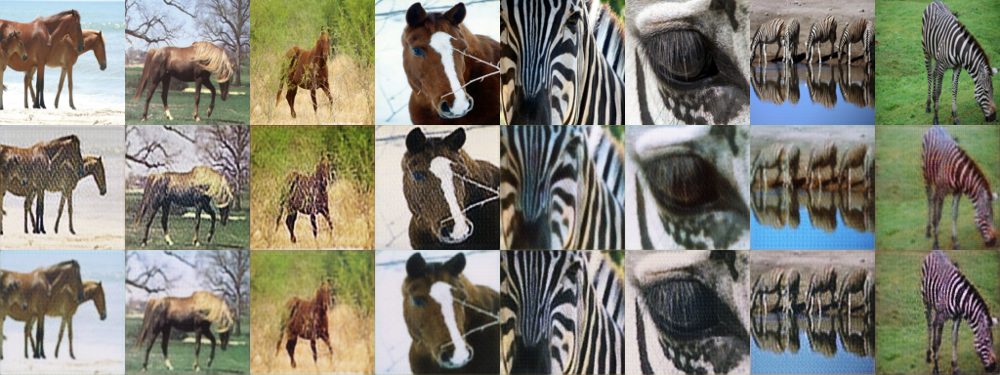

('[0/150][450] Loss_D: 0.269376 0.247774 Loss_G: 0.294303 0.471215 loss_cyc 0.179130', 189.18976593017578)
A (2, 4, 128, 128, 3)


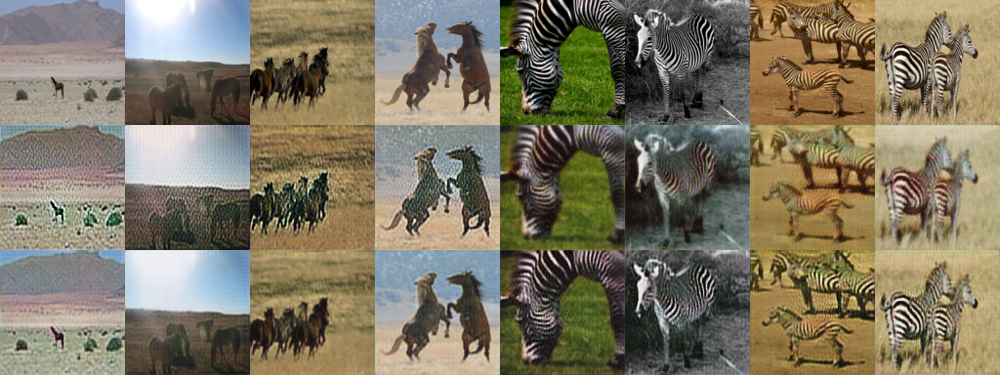

('[0/150][500] Loss_D: 0.267482 0.253809 Loss_G: 0.341820 0.465228 loss_cyc 0.171407', 210.2780749797821)
A (2, 4, 128, 128, 3)


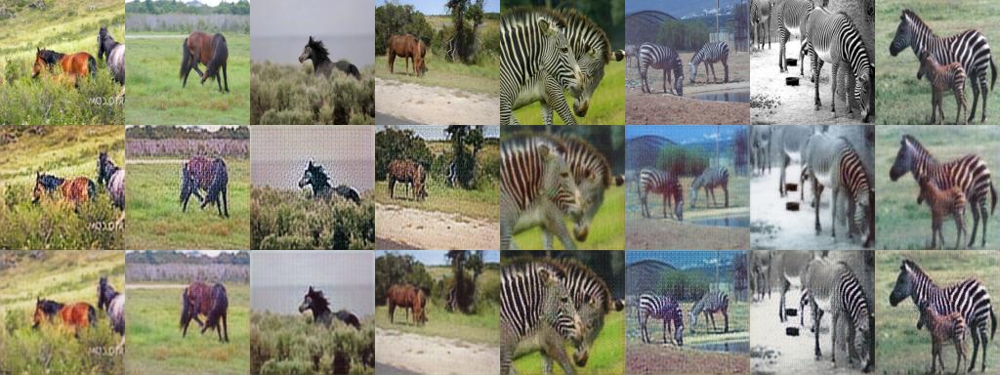

('[0/150][550] Loss_D: 0.269752 0.268969 Loss_G: 0.341147 0.485620 loss_cyc 0.169718', 231.338947057724)
A (2, 4, 128, 128, 3)


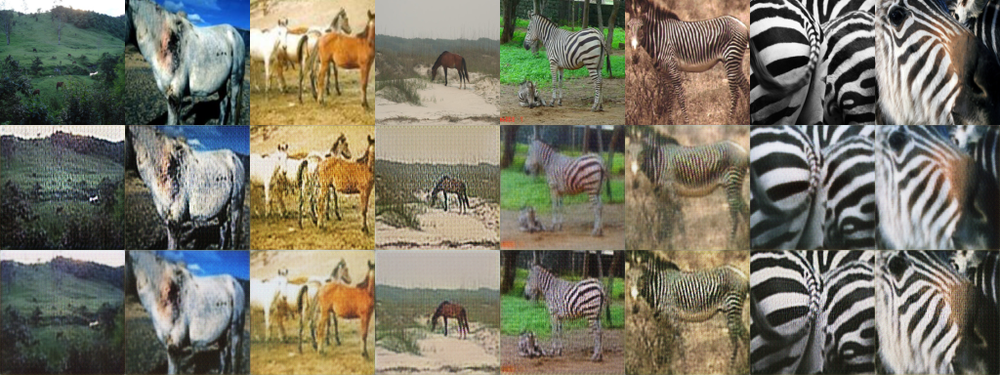

('[0/150][600] Loss_D: 0.280288 0.267611 Loss_G: 0.317813 0.448967 loss_cyc 0.172961', 252.39058589935303)
A (2, 4, 128, 128, 3)


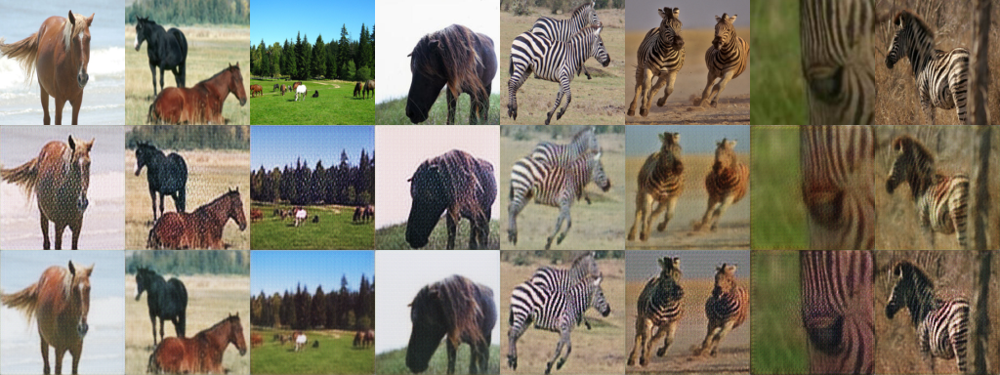

('[0/150][650] Loss_D: 0.271034 0.258991 Loss_G: 0.310709 0.457465 loss_cyc 0.170622', 273.47767210006714)
A (2, 4, 128, 128, 3)


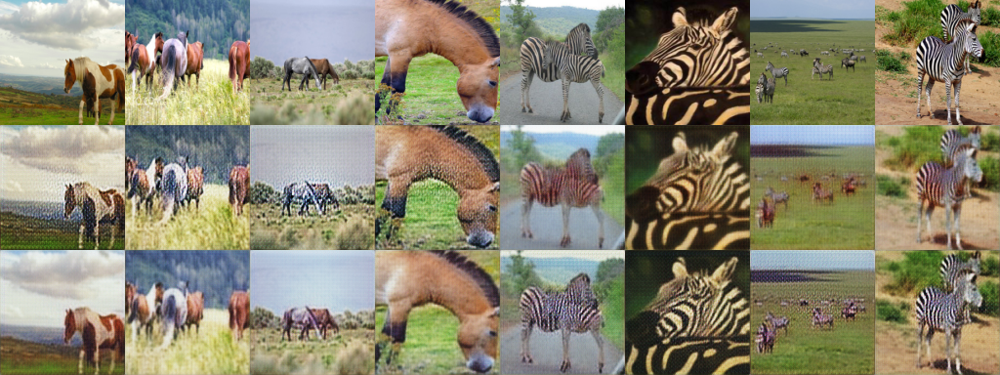

('[0/150][700] Loss_D: 0.271234 0.263165 Loss_G: 0.321934 0.426943 loss_cyc 0.175500', 294.5407168865204)
A (2, 4, 128, 128, 3)


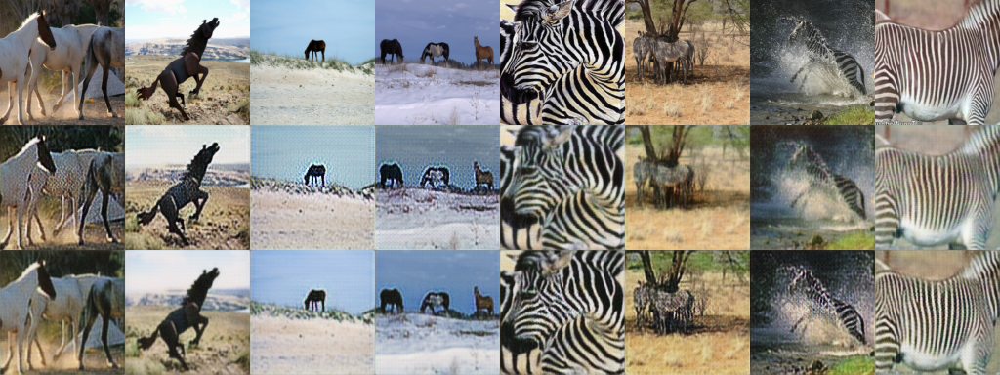

('[0/150][750] Loss_D: 0.272233 0.283370 Loss_G: 0.350574 0.436089 loss_cyc 0.165966', 315.59628200531006)
A (2, 4, 128, 128, 3)


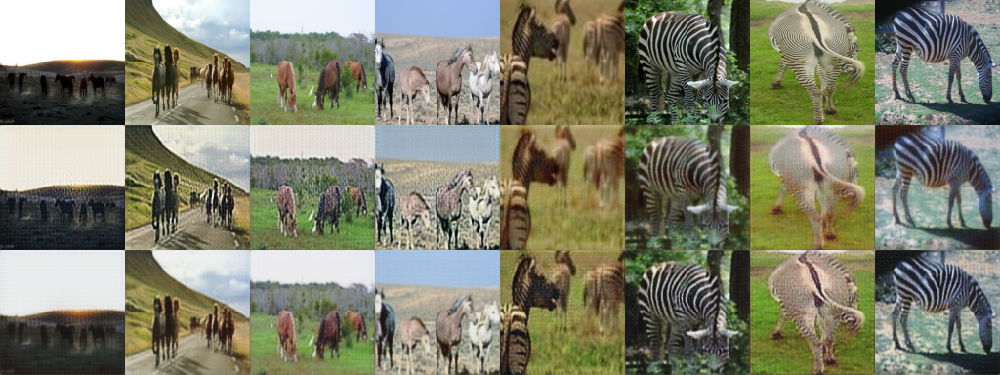

('[0/150][800] Loss_D: 0.277246 0.255598 Loss_G: 0.335289 0.429838 loss_cyc 0.163477', 336.6537320613861)
A (2, 4, 128, 128, 3)


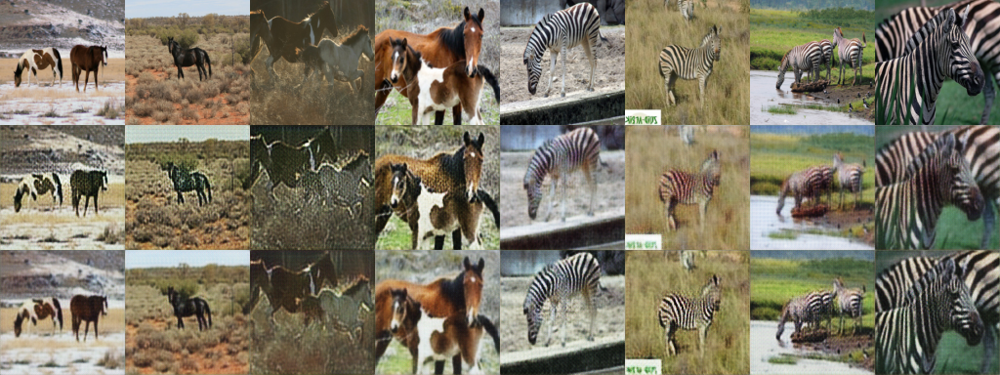

('[0/150][850] Loss_D: 0.267652 0.252613 Loss_G: 0.319005 0.455515 loss_cyc 0.163065', 357.67780089378357)
A (2, 4, 128, 128, 3)


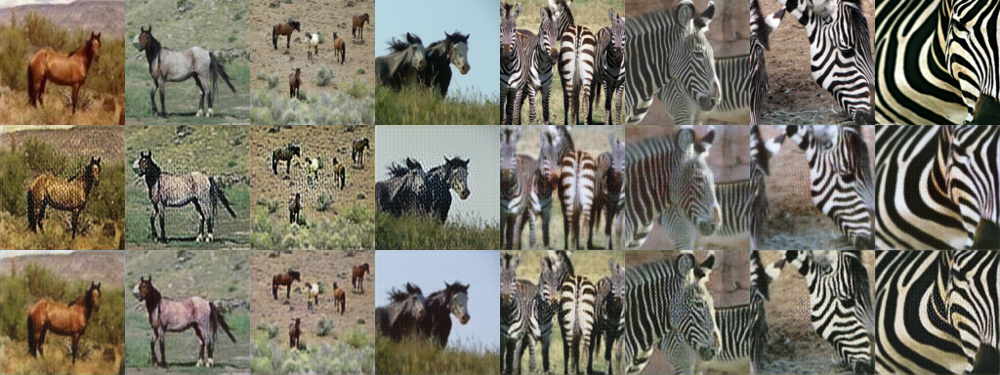

('[0/150][900] Loss_D: 0.277524 0.275387 Loss_G: 0.354482 0.406756 loss_cyc 0.157637', 378.73054790496826)
A (2, 4, 128, 128, 3)


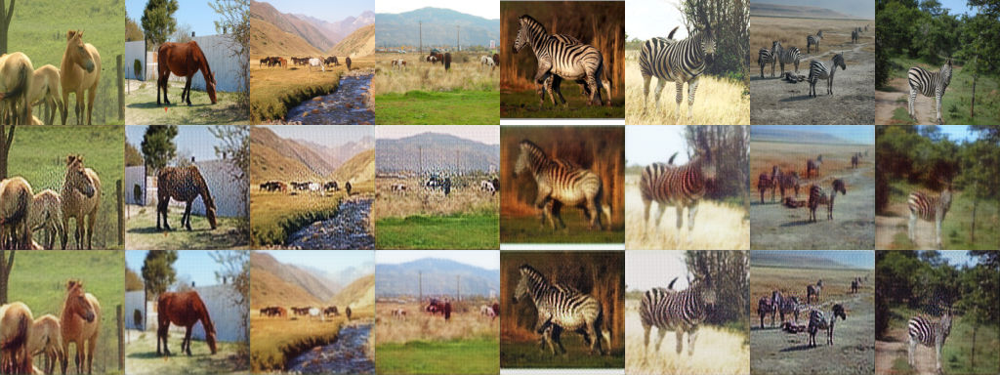

('[0/150][950] Loss_D: 0.284057 0.238540 Loss_G: 0.341825 0.401550 loss_cyc 0.158817', 399.78531408309937)
A (2, 4, 128, 128, 3)


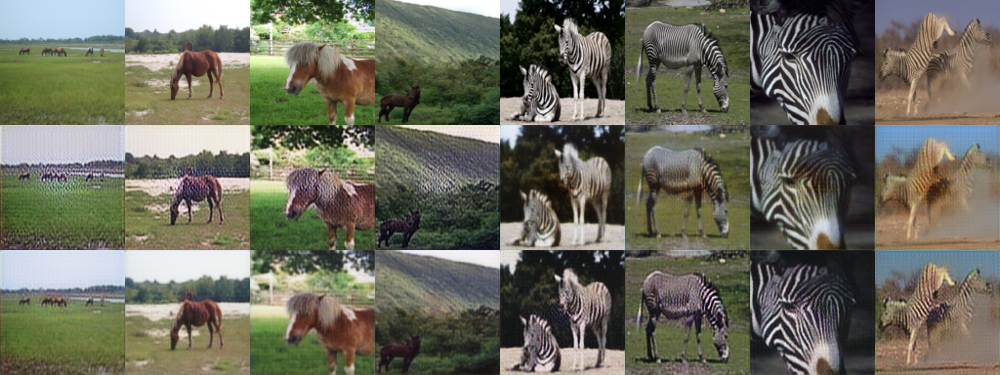

('[1/150][1000] Loss_D: 0.274402 0.249802 Loss_G: 0.318083 0.422947 loss_cyc 0.153631', 420.8476839065552)
A (2, 4, 128, 128, 3)


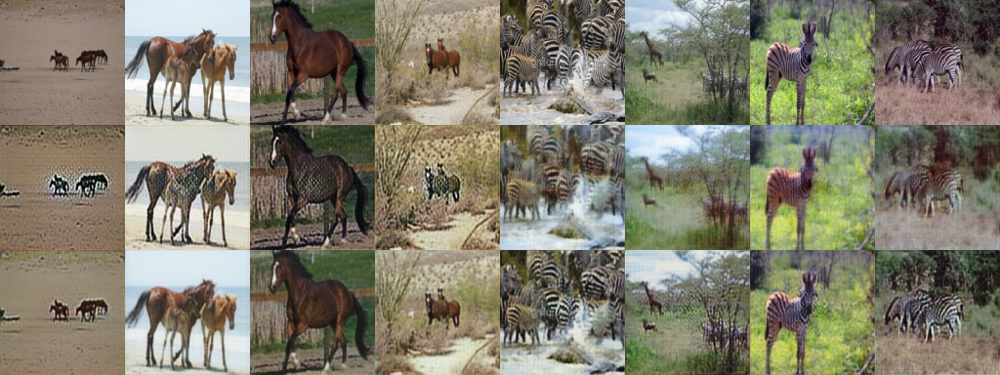

('[1/150][1050] Loss_D: 0.261568 0.258759 Loss_G: 0.332000 0.415904 loss_cyc 0.159907', 441.9190640449524)
A (2, 4, 128, 128, 3)


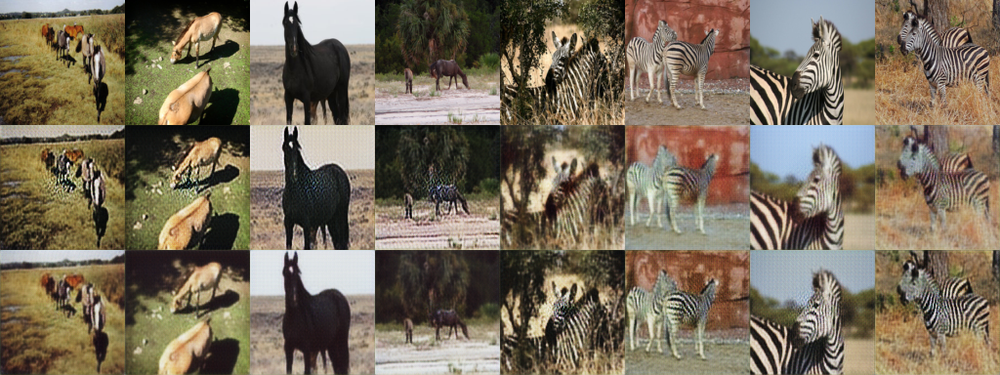

('[1/150][1100] Loss_D: 0.265732 0.264534 Loss_G: 0.356999 0.456322 loss_cyc 0.152656', 462.9921820163727)
A (2, 4, 128, 128, 3)


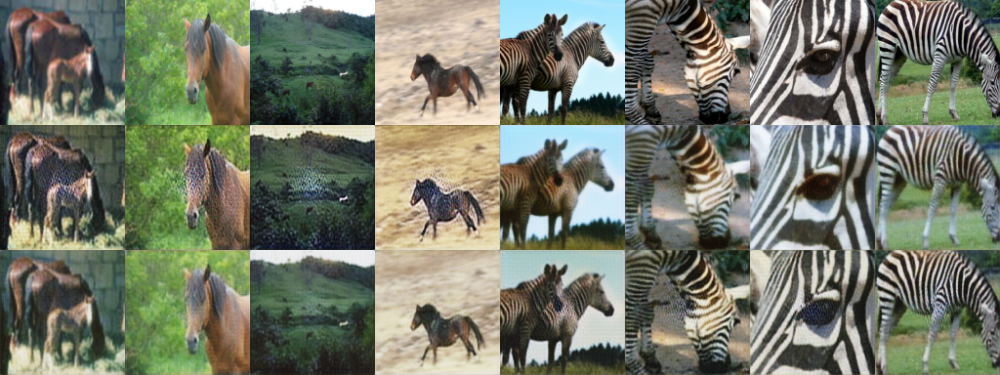

('[1/150][1150] Loss_D: 0.272237 0.261410 Loss_G: 0.335495 0.416391 loss_cyc 0.152046', 484.037584066391)
A (2, 4, 128, 128, 3)


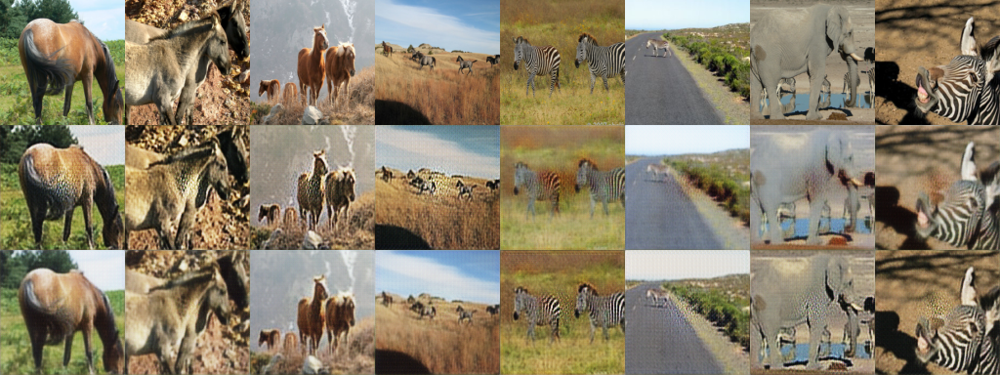

('[1/150][1200] Loss_D: 0.283394 0.275506 Loss_G: 0.349512 0.445019 loss_cyc 0.151491', 505.08634305000305)
A (2, 4, 128, 128, 3)


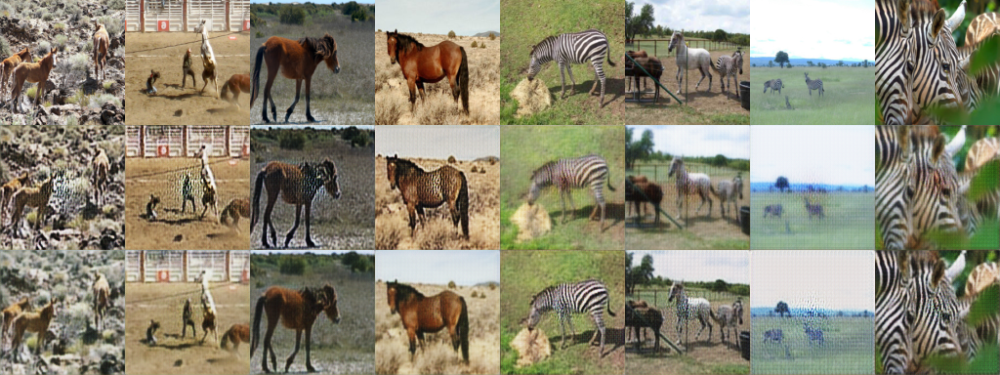

('[1/150][1250] Loss_D: 0.269637 0.253351 Loss_G: 0.315172 0.425126 loss_cyc 0.149719', 526.1450009346008)
A (2, 4, 128, 128, 3)


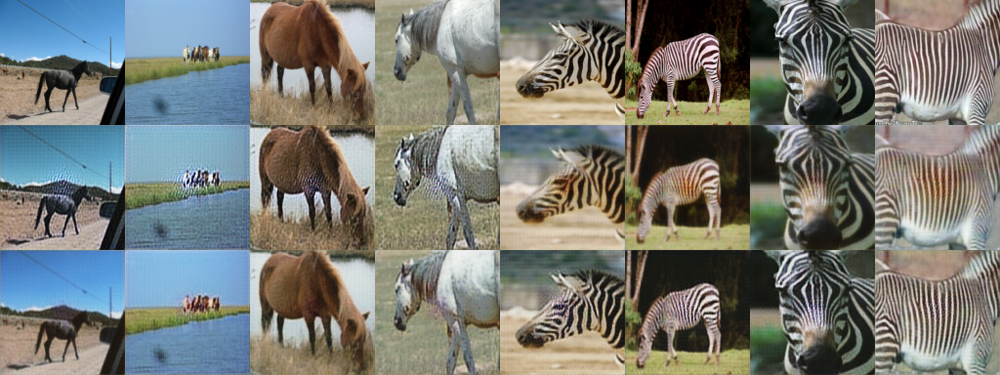

('[1/150][1300] Loss_D: 0.257237 0.250137 Loss_G: 0.319947 0.462533 loss_cyc 0.147750', 547.2346699237823)
A (2, 4, 128, 128, 3)


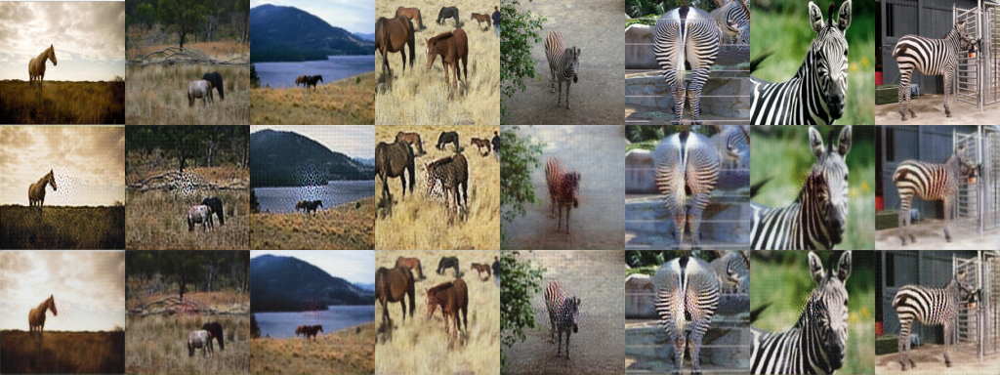

('[1/150][1350] Loss_D: 0.281495 0.264688 Loss_G: 0.333788 0.436309 loss_cyc 0.147014', 568.3138220310211)
A (2, 4, 128, 128, 3)


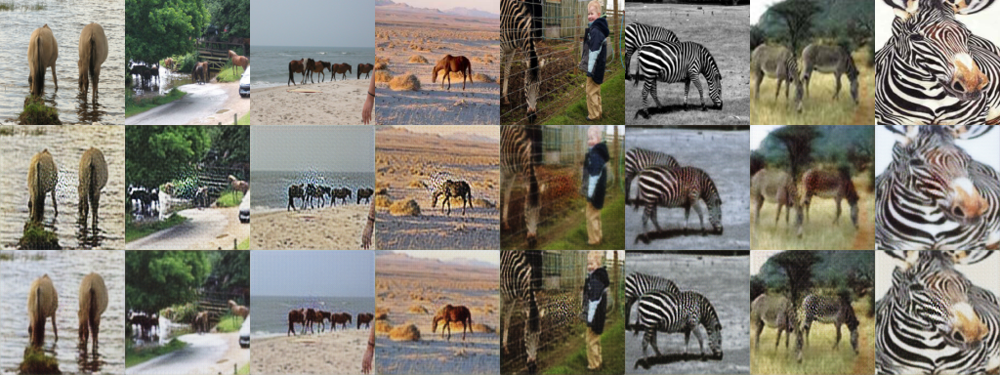

('[1/150][1400] Loss_D: 0.259420 0.247108 Loss_G: 0.347317 0.465129 loss_cyc 0.144952', 589.3972480297089)
A (2, 4, 128, 128, 3)


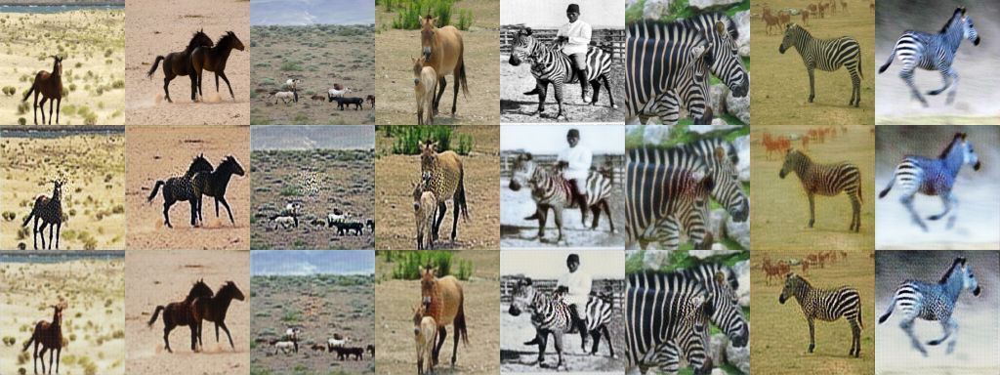

('[1/150][1450] Loss_D: 0.256575 0.244010 Loss_G: 0.350467 0.464464 loss_cyc 0.143446', 610.4456861019135)
A (2, 4, 128, 128, 3)


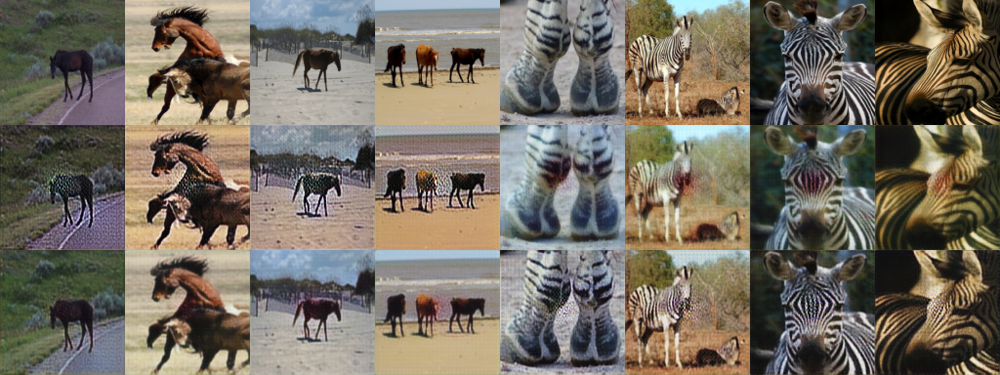

('[1/150][1500] Loss_D: 0.289584 0.235544 Loss_G: 0.386177 0.468985 loss_cyc 0.149996', 631.5077409744263)
A (2, 4, 128, 128, 3)


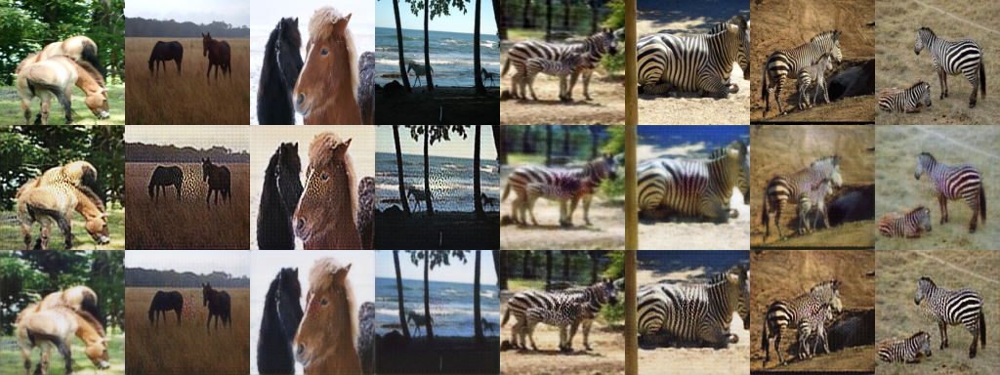

('[1/150][1550] Loss_D: 0.265338 0.249222 Loss_G: 0.364473 0.456164 loss_cyc 0.147179', 652.5752749443054)
A (2, 4, 128, 128, 3)


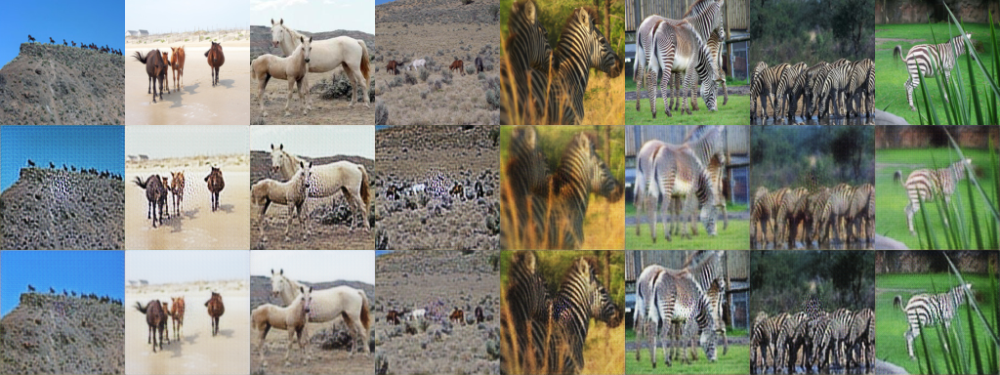

('[1/150][1600] Loss_D: 0.280215 0.254896 Loss_G: 0.335992 0.456029 loss_cyc 0.147636', 673.6734759807587)
A (2, 4, 128, 128, 3)


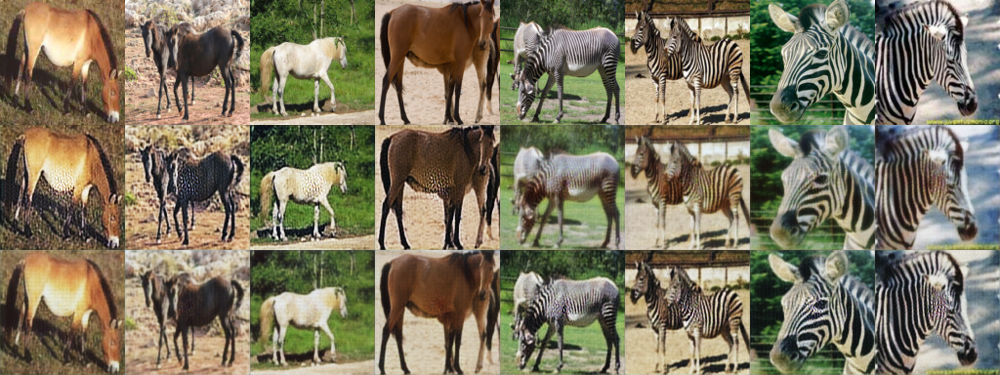

('[1/150][1650] Loss_D: 0.274383 0.269811 Loss_G: 0.327854 0.415285 loss_cyc 0.139838', 694.7361319065094)
A (2, 4, 128, 128, 3)


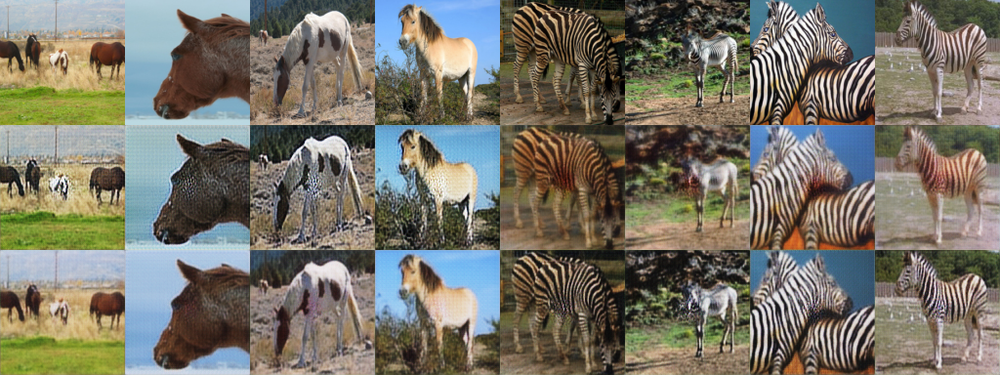

('[1/150][1700] Loss_D: 0.260442 0.242726 Loss_G: 0.350235 0.485142 loss_cyc 0.141793', 715.8152499198914)
A (2, 4, 128, 128, 3)


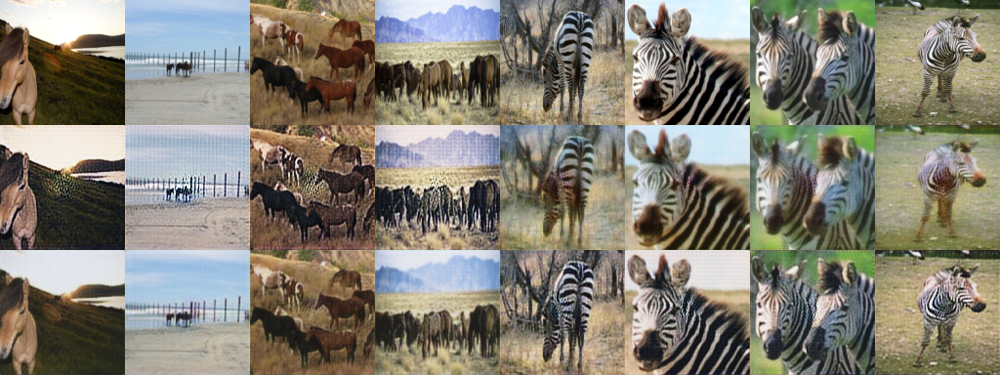

('[1/150][1750] Loss_D: 0.277679 0.258403 Loss_G: 0.351131 0.449198 loss_cyc 0.138862', 736.8689389228821)
A (2, 4, 128, 128, 3)


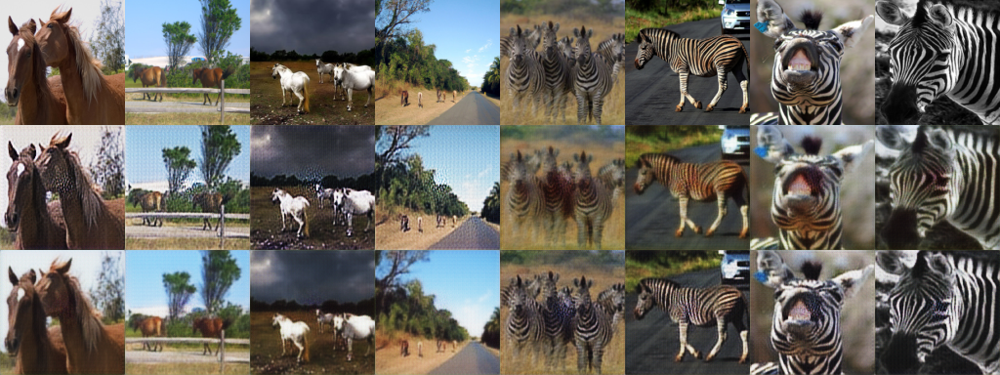

('[1/150][1800] Loss_D: 0.273394 0.273429 Loss_G: 0.337230 0.439721 loss_cyc 0.137758', 757.9399230480194)
A (2, 4, 128, 128, 3)


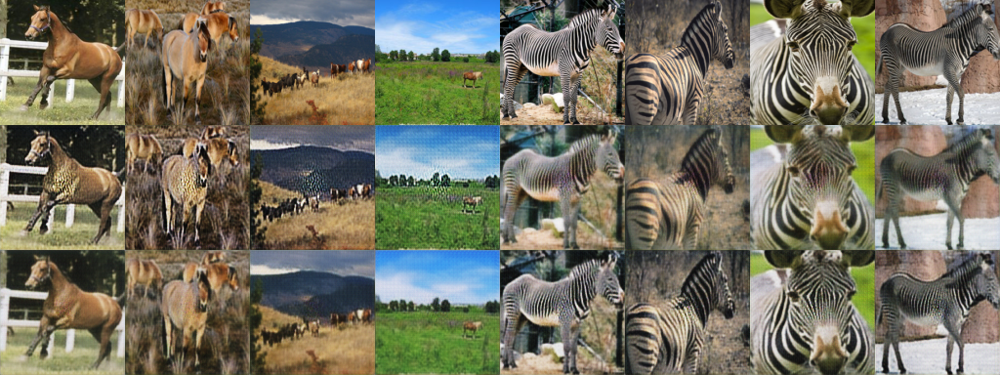

('[1/150][1850] Loss_D: 0.268002 0.242023 Loss_G: 0.333825 0.449360 loss_cyc 0.140820', 778.9847490787506)
A (2, 4, 128, 128, 3)


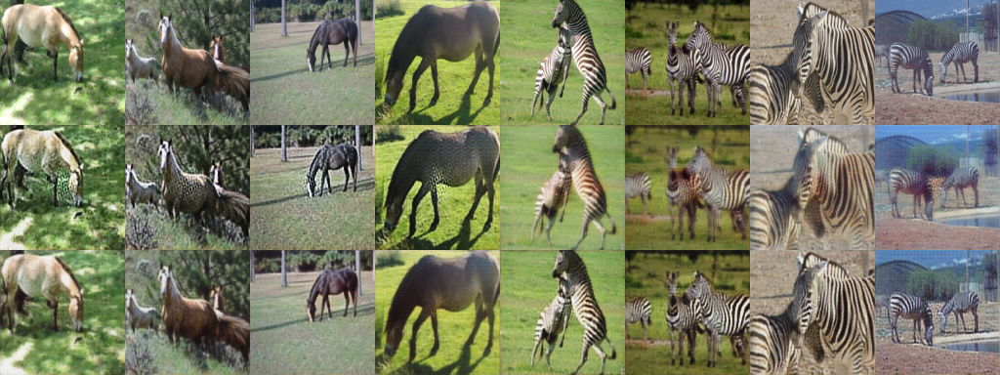

('[1/150][1900] Loss_D: 0.266179 0.255114 Loss_G: 0.349412 0.474599 loss_cyc 0.139267', 800.0310518741608)
A (2, 4, 128, 128, 3)


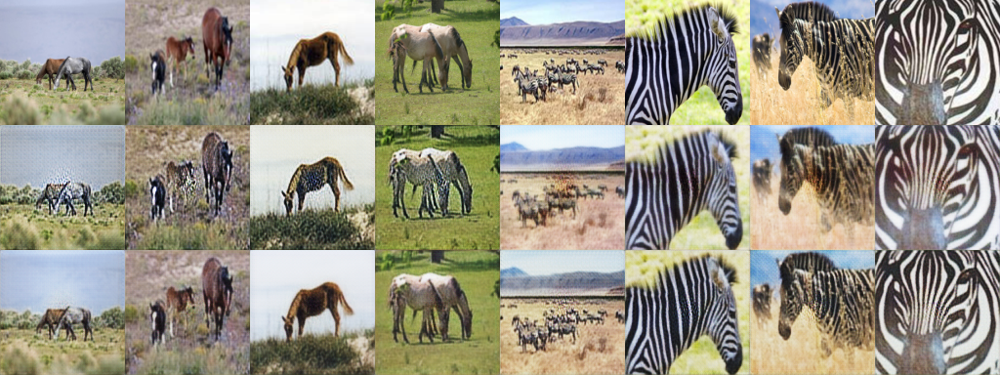

('[1/150][1950] Loss_D: 0.267724 0.247900 Loss_G: 0.355154 0.455945 loss_cyc 0.131216', 821.104574918747)
A (2, 4, 128, 128, 3)


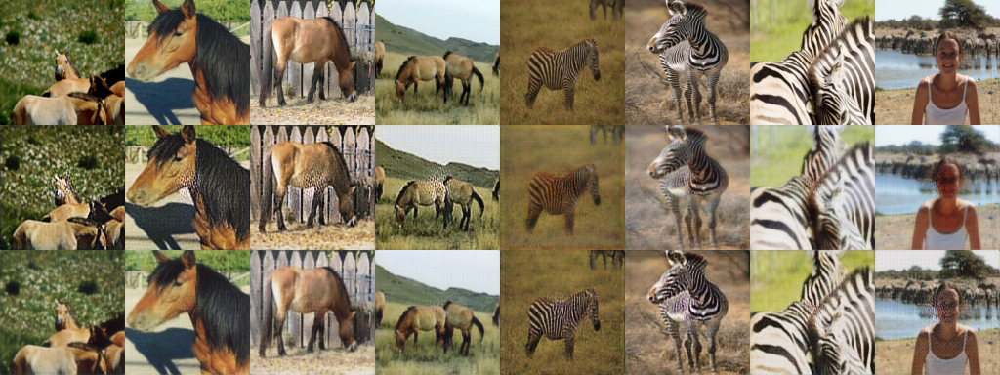

('[2/150][2000] Loss_D: 0.269563 0.270335 Loss_G: 0.312899 0.469665 loss_cyc 0.135074', 842.1695969104767)
A (2, 4, 128, 128, 3)


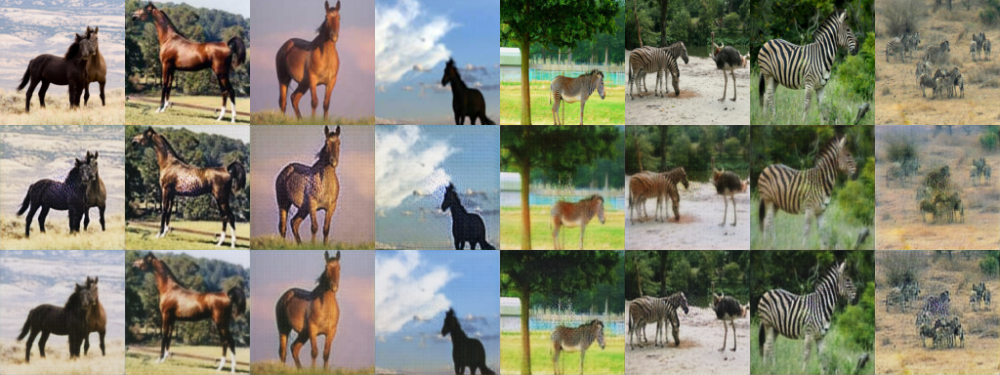

('[2/150][2050] Loss_D: 0.263923 0.244013 Loss_G: 0.338377 0.486598 loss_cyc 0.139671', 863.2203750610352)
A (2, 4, 128, 128, 3)


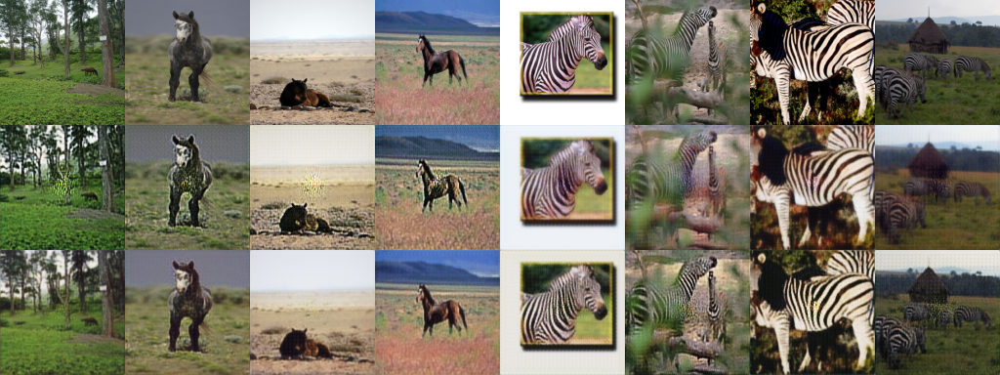

('[2/150][2100] Loss_D: 0.271673 0.256296 Loss_G: 0.337875 0.450609 loss_cyc 0.129569', 884.2833988666534)
A (2, 4, 128, 128, 3)


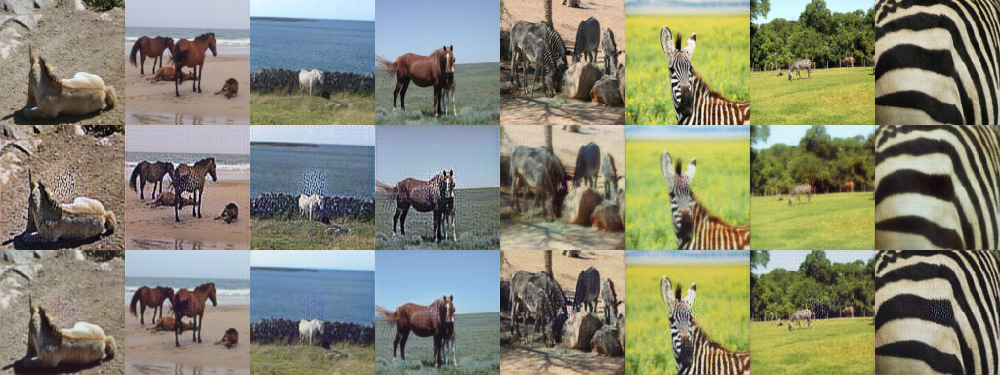

('[2/150][2150] Loss_D: 0.253159 0.242653 Loss_G: 0.340449 0.458762 loss_cyc 0.130337', 905.3586869239807)
A (2, 4, 128, 128, 3)


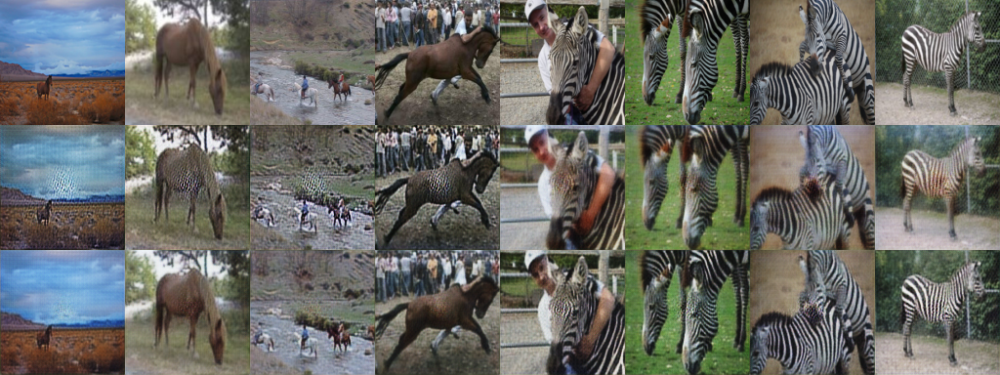

KeyboardInterrupt: 

In [79]:
import time
from IPython.display import clear_output
t0 = time.time()
niter = 150
gen_iterations = 0
epoch = 0
errCyc_sum = errGA_sum = errGB_sum = errDA_sum = errDB_sum = 0

display_iters = 50
#val_batch = minibatch(valAB, 6, direction)
train_batch = minibatchAB(train_A, train_B, batchSize)

while epoch < niter: 
    epoch, A, B = next(train_batch)        
    errDA, errDB  = netD_train([A, B])
    errDA_sum +=errDA
    errDB_sum +=errDB

    # epoch, trainA, trainB = next(train_batch)
    errGA, errGB, errCyc = netG_train([A, B])
    errGA_sum += errGA
    errGB_sum += errGB
    errCyc_sum += errCyc
    gen_iterations+=1
    if gen_iterations%display_iters==0:
        #if gen_iterations%(5*display_iters)==0:
#         clear_output()
        print('[%d/%d][%d] Loss_D: %f %f Loss_G: %f %f loss_cyc %f'
        % (epoch, niter, gen_iterations, errDA_sum/display_iters, errDB_sum/display_iters,
           errGA_sum/display_iters, errGB_sum/display_iters, 
           errCyc_sum/display_iters), time.time()-t0)
        _, A, B = train_batch.send(4)
        showG(A,B)        
        errCyc_sum = errGA_sum = errGB_sum = errDA_sum = errDB_sum = 0

In [81]:
# save model and load model
from keras.models import save_model, load_model
from os.path import join
save_model(join'''./model')
netDA